# Laboratorio 1: Regresión en California

En este laboratorio deben hacer experimentos de regresión con el conjunto de datos "California Housing dataset".

Estudiarán el dataset, harán visualizaciones y seleccionarán atributos relevantes a mano.

Luego, entrenarán y evaluarán diferentes tipos de regresiones, buscando las configuraciones que mejores resultados den.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

## Carga del Conjunto de Datos

Cargamos el conjunto de datos y vemos su contenido.

In [2]:
from sklearn.datasets import fetch_california_housing
X_california, y_california = fetch_california_housing(return_X_y=True, as_frame=True)
california = fetch_california_housing()

In [3]:
california.keys()

dict_keys(['data', 'target', 'frame', 'target_names', 'feature_names', 'DESCR'])

In [4]:
print(california['DESCR'])  # descripción del dataset
#california['feature_names'] # nombres de los atributos para cada columna de 'data'
#california['data']           # matriz con los datos de entrada (atributos)
#print(california['target']) # vector de valores a predecir

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block group
        - HouseAge      median house age in block group
        - AveRooms      average number of rooms per household
        - AveBedrms     average number of bedrooms per household
        - Population    block group population
        - AveOccup      average number of household members
        - Latitude      block group latitude
        - Longitude     block group longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
https://www.dcc.fc.up.pt/~ltorgo/Regression/cal_housing.html

The target variable is the median house value for California districts,
expressed in hundreds of thousands of dollars ($100,000).

This dataset was derived

In [5]:
california['data'].shape, california['target'].shape

((20640, 8), (20640,))

## División en Entrenamiento y Evaluación

Dividimos aleatoriamente los datos en 80% para entrenamiento y 20% para evaluación:

In [6]:
from sklearn.model_selection import train_test_split
X, y = california['data'], california['target']
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=0)
X_train.shape, X_test.shape

((16512, 8), (4128, 8))

In [7]:
y.shape

(20640,)

In [8]:
y_test.shape

(4128,)

## Ejercicio 1: Descripción de los Datos y la Tarea

Responda las siguientes preguntas:

1. ¿De qué se trata el conjunto de datos?
2. ¿Cuál es la variable objetivo que hay que predecir? ¿Qué significado tiene?
3. ¿Qué información (atributos) hay disponibles para hacer la predicción?
4. ¿Qué atributos imagina ud. que serán los más determinantes para la predicción?
5. ¿Qué problemas observa a priori en el conjunto de datos? ¿Observa posibles sesgos, riesgos, dilemas éticos, etc? Piense que los datos pueden ser utilizados para hacer predicciones futuras.

**No hace falta escribir código para responder estas preguntas.**

Respuestas:
1. Esta base de datosrefiere a la situación socioeconómica e inmobiliarias en Californi, proveniente de un censo en Estados unidos en 1990a.Dicho censo utiliza como unidad mínima geográfica el grupo de bloques (*block group*), que suele abarcar entre 600 y 3000 personas, por lo que cada fila de la base de datos hace referencia a un grupo de bloques.  Incluye informacóon acerca de laantigüedadd media de las casas en el grupo de bloques, ingresso mediso en el grupo de bloques, número promedio de habitaciones por hogar, número promedio de dormitorios por hogar, población del grupo de bloques, número promedio de miembros por hogar latitud y longitud del grupo de bloques. Estos datos derivaron del censo de EE.UU. de 1990, donde una fila representa a un grupo de bloques del censo
   .2
2. La variable objetivo a predecir es el valor medio de la casas de los distritos de Californ, expresado en cientos de miles de dólares estadounidensesia. El significado de la variable objetivo es importante por las siguientes razones:

  a) Es un indicador Econóicas de los distritos de California. Altos valores pueden indicar áreas prósperas y de alto costo de vida, mientras que bajos valores pueden sugerir áreas con menos desarrollo económico.
Puede aportar i  b) Infórmacion para la toma de políticas de vivienda debido a que esta variable puede ser utilizada por las autoridades y planificadores urbanos para diseñar políticas de vivienda y desaurbano. Entender dónde los precios de las viviendas son altos o bajos puede ayudar a enfocar esfuerzos en áreas necesitadasétambien.

  c) Informacion para el mercado inmobya que,o porque para agentes inmobiliarios y compradores, conocer el valor medio de las casas en una zona específica es crucial para la toma de decisiones de compra y venta.

  d) Estudios Demográficos: Los investigadores pueden utilizar esta variable para estudiar la relación entre el valor de las casas y otras características demográficas   comoeducación, eldensidad poblacionalud pública.

  e) Predicción de Tendencias: Predecir el valor de las casas puede ayudar a anticipar cambios en el mercado inmobiliario, permitiendo a los inversores y propietarios tomar decisiones informadas.

3. Los atributos disponibles para hacór la p
   
    - MedInc        median income in block group
    - HouseAge      median house age in block group
    - AveRooms      average number of rooms per household
    - AveBedrms     average number of bedrooms per household
    - Population    block group population     - AveOccup      average number of household me
    - Latitude      block group latitude
    - Longitude     block group longitude
  
u4eitude   
    4block group longitude
4. Para predecir el valor medio de las casas en los distritos de California, als atributos que probablemente serán los más determinantes incluyen el ingreso medio (MedInc), ya que es un fuerte indicador del poder adquisitivo de los residentes y, por tanto, influye direct la latitud y longitud (Latitude y Longitude), ya que probablemente existan zonas más costosas y más económicas dentro del estado. Por otro lado mente en los precios de las viviendas; nuevas suelen tener precios más altos; el número promedio de habitaciones (AveRoo,amaño y funcionalidad de las viviendas; la poblacy uede afectar la demanda y los precios; el número pr pueden no aportar información significativa a la hora de predecir los precios. Por ejemplo, probablemente existan casas antiguas muy costosas y también muy económicas (por ejemplo una mansión en una zona costosa versus un edificio desactualizado y en mal estado en una zona más económica). Algo similar podría decirse del número de habitaciones/dormitorios y de la ocupación media: una zona densamente poblada podría ser un condominio exlusivo con un elevado costo inmobiliario, o una zona de viviendas planificadas destinadas a gente con menos recursos económicos, donde las propiedades tienen un costo menor. Para estas variables, esperamos que sea más difícil establecer una relación directa con la variable objetivo.ci5l en la valora5ión de las viviendas.

5. Al analizar el conjunto de datos de valores de casas en los distritos de California, se pueden identificar varios problemas y consideraciones a priori, incluyendo posibles sesgos, riesgos y dilemas éticos, especialmente si los datos se utilizan )ara hacer predicciones futuras:

      a) Sesgo Geográfico y Socioeconómico: Dado que los datos provienen de un censo de 1990, pueden reflejar sesgos históricos en la distribución de riqueza y desarrollo en California. Áreas que históricamente han sido más ricas pueden seguir mostrando altos valores de viviendas, mientras que zonas desfavorecidas pueden perpetuar la percepción de bajo valor, lo que podría influir en deci siones de inversión y desarrollo.

      b)Desactualización de Datos: Los datos de 1990 pueden no ser representativos de la situación actual. El mercado inmobiliario, las políticas de vivienda y las condiciones económicas han cambiado significativamente desde entonces. Utilizar estos datos para hacer predicciones futuras sin considerar cambios recientes puede llevar a resultad os inexactos y decisiones erróneas.

      c)Riesgos de Discriminación: Si los modelos predictivos se utilizan para decisiones críticas, como la concesión de préstamos o políticas de vivienda, podrían perpetuar la discriminación contra grupos desfavorecidos. Por ejemplo, áreas con menor valor de viviendas históricamente asociadas con minorías étnicas o grupos de bajos ingresos podrían ser subvaloradas, perpe tuando ciclos de pobreza y exclusión.

      d)Privacidad y Confidencialidad: Aunque los datos están anonimizados, el uso indebido de información geográfica detallada podría llevar a problemas de privacidad. La combinación de diferentes conjuntos de datos podría potencialmente identificar a individuos o grupos específicos.

      e)Interpretación Errónea de Variables: Algunos atributos, como el número promedio de habitaciones y dormitorios por hogar, pueden ser mal interpretados. Áreas con muchas casas vacías (como resorts) pueden mostrar valores atípicos que no reflejan las condiciones reales del mercado  inmobiliario para residentes permanentes.

      f)Influencia de Factores Externos: Variables importantes que no están incluidas en el conjunto de datos, como la proximidad a centros de trabajo, calidad de escuelas, tasas de criminalidad y cambios en infraestructuras, pueden influir significativamente en los precios de las viviendas. La falta de estas variables puede lle var a modelos incompletos y menos precisos.

      g)Dilemas Éticos en la Predicción: Utilizar estos datos para influir en políticas de desarrollo urbano y vivienda debe hacerse con precaución para evitar exacerbar desigualdades sociales y económicas. Es importante considerar el impacto social y económico de las predicciones y decisiones basadas en estos datos.

## Ejercicio 2: Visualización de los Datos

1. Para cada atributo de entrada, haga una gráfica que muestre su relación con la variable objetivo.
2. Estudie las gráficas, identificando **a ojo** los atributos que a su criterio sean los más informativos para la predicción.
3. Para ud., ¿cuáles son esos atributos? Lístelos en orden de importancia.

Utilizando Pandas y Seaborn, podemos realizar una visualización rápida de todas las variables y sus correlaciones. En particular, la última fila de la siguiente gráfica corresponde a las correlaciones de la variable objetivo con las features de interés.

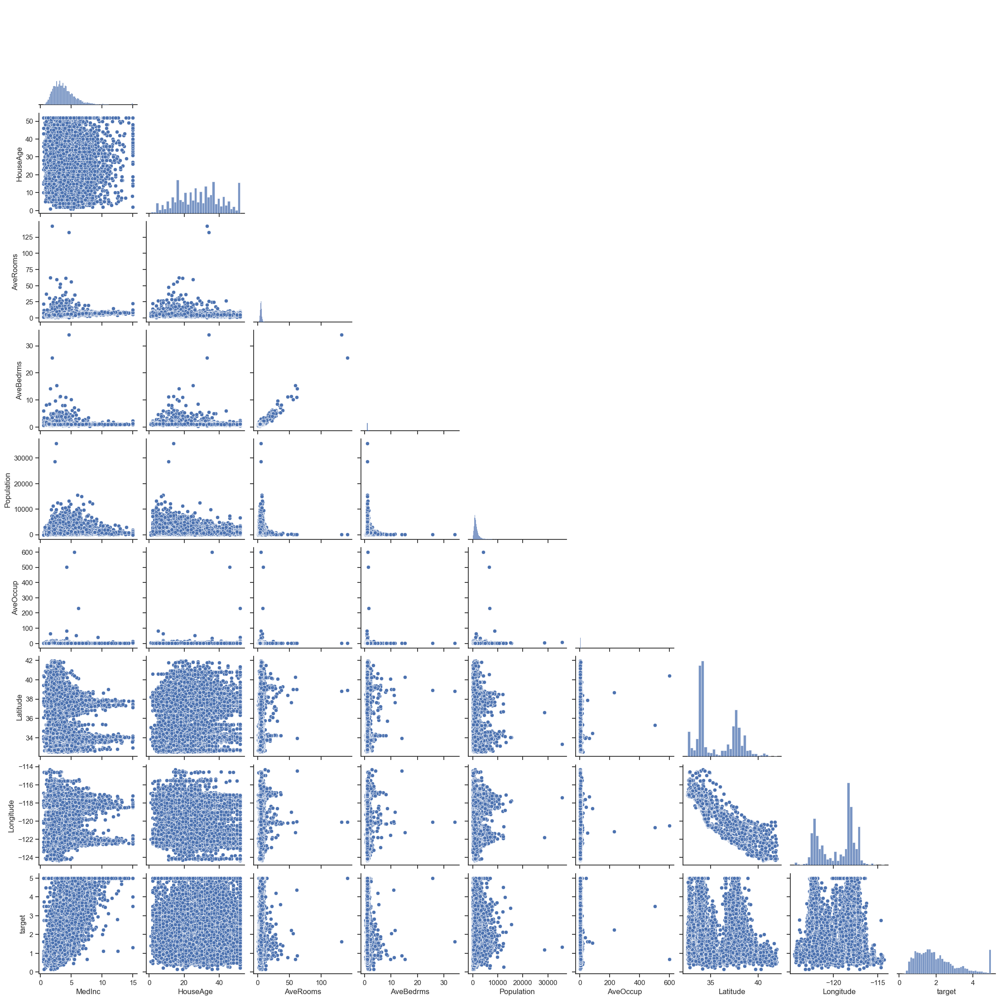

In [9]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
import seaborn as sns

training_df = pd.DataFrame(X_train, columns=california['feature_names'])
training_df['target'] = y_train


sns.set_theme(style="ticks")
sns.pairplot(training_df, corner=True)

La diagonal nos muestra los histogramas de cada variable. Podemos ver que para algunos de ellos existen outliers, es decir, datos que asumen un valor muy lejano al rango habitual. Además, el rango alcanzado por cada variable es distinto, algo que generalmente se busca evitar.

Utilizaremos el Rango Intercuartílico (IQR) para filtrar todas las columnas. Eliminamos los datos que están por encima de $Q_3+1.5 IQR$ o por debajo de $Q_1-1.5 IQR$:

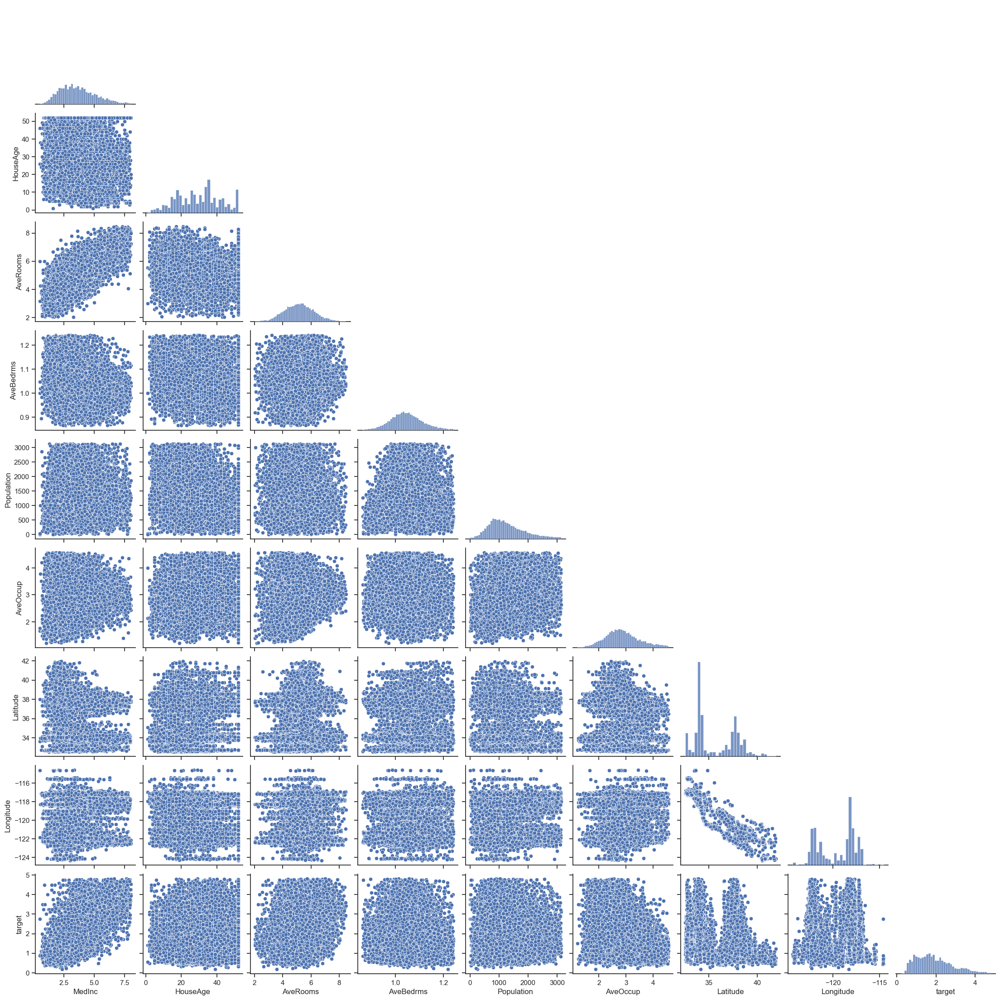

In [10]:
def filter_iqr(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Filtering out the outliers
    df_filtered = df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]
    return df_filtered

filtered_df = filter_iqr(training_df)
sns.pairplot(filtered_df, corner=True)

En la diagonal del plot podemos ver que el histograma de cada variable muestra claramente las distribuciones. Vamos a normalizar usando StandardScaler. Además, el gráfico tipo scatter no permite conocer la densidad de puntos (ya que los puntos se superponen), haciendo difícil observar las correlaciones. Vamos a cambiar el estilo de gráfica por un histograma 2D.

También es interesante ver que el scatter de `Longitude` vs. `Latitude` se parece a la silueta del estado de California, como es de esperar. Vamos a usar esta idea más adelante.

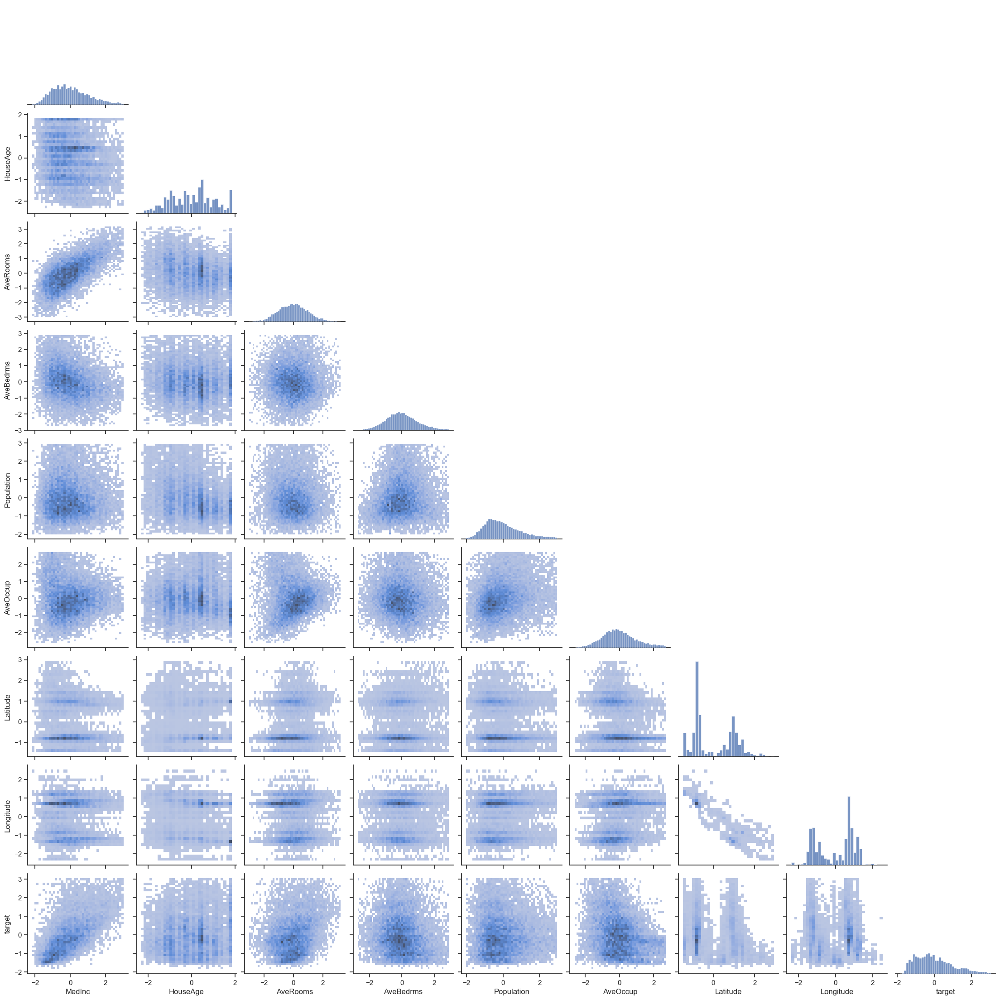

In [11]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
norm_data = scaler.fit_transform(filtered_df.values)
norm_df = pd.DataFrame(norm_data, columns=filtered_df.columns)
sns.pairplot(norm_df, corner=True, kind='hist')

En base a los plots de la última fila (target vs. todas la features), podemos ver que:

*   `MedInc` parece tener la mayor correlación (lineal) con la variable objetivo.
*  `AveRooms` podría aportar información significativa. A su vez, ésta feature está correlacionada con `AveOccup`, por lo que podría esperarse que ambas aporten información similar.
* `AveBedrms` y `Population` no muestran signos de una correlación apreciable.
* `HouseAge` parece estar distribuida uniformemente respecto a la variable objetivo, es decir que existen casas de todas las antigüedades para cada precio.
* Las variables `Latitude` y `Longitude` no parecen aportar demasiada información. Esto es de esperar, ya que en caso de existir una correlación, ésta no sería lineal (lo más probable es que puedan encontrarse zonas con coordenadas cercanas cuyos precios coincidan).

Podemos chequear esto último utilizando `plotly` para graficar los datos disponibles sobre el mapa de California, vinculando el color de cada punto con la variable objetivo:


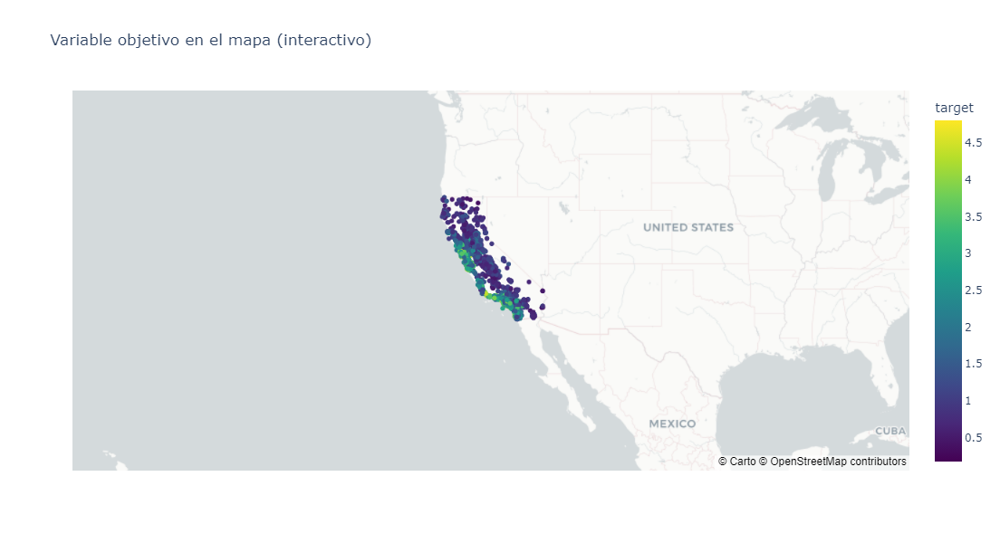

In [12]:
import plotly.express as px

fig = px.scatter_mapbox(
    filtered_df,
    lat="Latitude",
    lon="Longitude",
    color="target",
    color_continuous_scale=px.colors.sequential.Viridis,
    size_max=15,
    zoom=3,
    mapbox_style="carto-positron",
    title="Variable objetivo en el mapa (interactivo)"
)

fig.update_layout(
    width=800,  # Set the width of the plot
    height=600  # Set the height of the plot
)

fig.show()

Como es de esperar, las propiedades más costosas son aquellas que se encuentran cerca de la costa, y en las ciudades más importantes del estado (San Francisco, Los Angeles, San Diego). Esta información podría resultar útil para realizar algún `clustering`, definiendo regiones más costosas y regiones más económicas. Evidentemente, este tipo de análsis es categórico y no permite establecer un ajuste (lineal o no) para predecir los precios como función de la latitud y la longitud.

## Ejercicio 3: Regresión Lineal

1. Seleccione **un solo atributo** que considere puede ser el más apropiado.
2. Instancie una regresión lineal de **scikit-learn**, y entrénela usando sólo el atributo seleccionado.
3. Evalúe, calculando error cuadrático medio para los conjuntos de entrenamiento y evaluación.
4. Grafique el modelo resultante, junto con los puntos de entrenamiento y evaluación.
5. Interprete el resultado, haciendo algún comentario sobre las cualidades del modelo obtenido.

**Observación:** Con algunos atributos se puede obtener un error en test menor a 50.

En base a lo visto recién, `MedInc` parece ser a feature que mejor podría explicar la variable objetivo. Vamos a entrenar el modelo de regresión lineal utilizando esta variable. Naturalmente, utilizamos el set de datos filtrado y normalizado para entrenamiento.

In [13]:
# 1. Resolver acá. Ayuda:
feature = 'MedInc'  # selecciono el atributo 'HouseAge'

X_train_f = norm_df[feature].values.reshape(-1, 1)
y_train_f = norm_df['target'].values.reshape(-1, 1)
X_train_f.shape, y_train_f.shape

((13077, 1), (13077, 1))

In [14]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
reg = LinearRegression().fit(X_train_f, y_train_f)

train_pred = reg.predict(X_train_f)
train_err  = mean_squared_error(y_train_f, train_pred)
print('Error de entrenamiento:', train_err)

Error de entrenamiento: 0.5944039000830372


Aplicamos la normalización ajustada al conjunto de entrenamiento sobre el conjunto de evaluación y evaluamos las predicciones de la regresión lineal sobre el mismo:

In [15]:
test_df = pd.DataFrame(X_test, columns=california['feature_names'])
test_df['target'] = y_test

norm_test = scaler.transform(test_df.values)

norm_test_df = pd.DataFrame(norm_test, columns=test_df.columns)

X_test_f = norm_test_df[feature].values.reshape(-1, 1)
y_test_f = norm_test_df['target'].values.reshape(-1, 1)

test_pred = reg.predict(X_test_f)
test_err  = mean_squared_error(y_test_f, test_pred)
#print(reg.score(X_test_f, y_test))
print('Error de evaluación:', test_err)

Error de evaluación: 0.8085956990554345


El error del ajuste es mayor en el conjunto de evaluación, como es de esperar.

Text(2, 1, 'MSE=0.81')

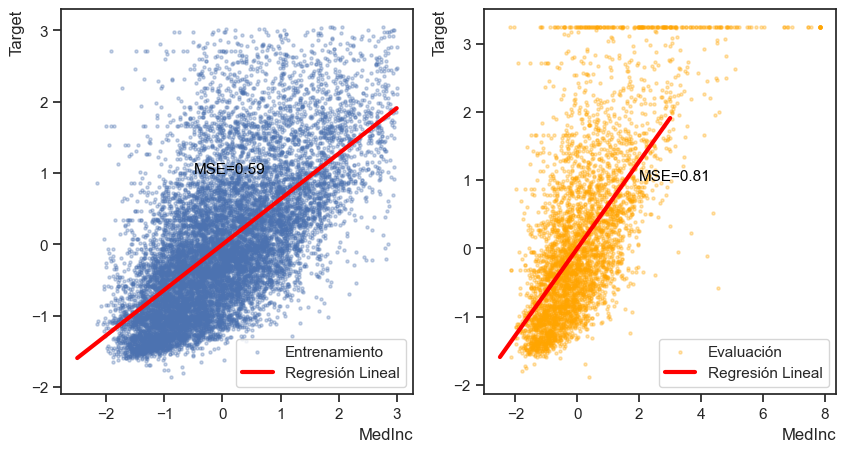

In [16]:
fig, ax = plt.subplots(1,2, figsize=(10,5))

x_plot = np.linspace(-2.5, 3, 10000)
y_plot = reg.predict(x_plot.reshape(-1, 1))

#y_pred  = reg.predict(y_test.reshape(-1, 1))

ax[0].scatter(X_train_f, y_train_f, zorder=2, alpha=0.3, s=5, label='Entrenamiento')
ax[0].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
ax[0].legend()
ax[0].set_xlabel('MedInc', loc='right')
ax[0].set_ylabel('Target', loc='top')
ax[0].text(-0.5, 1, f'MSE={np.round(train_err,2)}', fontsize=11, color='black')

ax[1].scatter(X_test_f, y_test_f, color='orange', zorder=2, alpha=0.3, s=5, label='Evaluación')
ax[1].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
ax[1].legend()
ax[1].set_xlabel('MedInc', loc='right')
ax[1].set_ylabel('Target', loc='top')
ax[1].text(2, 1, f'MSE={np.round(test_err,2)}', fontsize=11, color='black')


Vemos que una gran diferencia entre el conjunto de entrenamiento y el de evaluación es la gran cantidad de datos con el valor de target en el máximo, que son eliminados en el proceso de filtrado al preprocesar los datos de entrenamiento. Es posible que el `MSE` sea menor si no eliminamos los outliers en el set de entrenamiento. No obstante, como la idea es realizar un ajuste lineal, tiene sentido quedarse con los datos que permitan establecer esa relación.

Vamos a hacer ajustes lineales con las demás features para ver cómo es la performance:

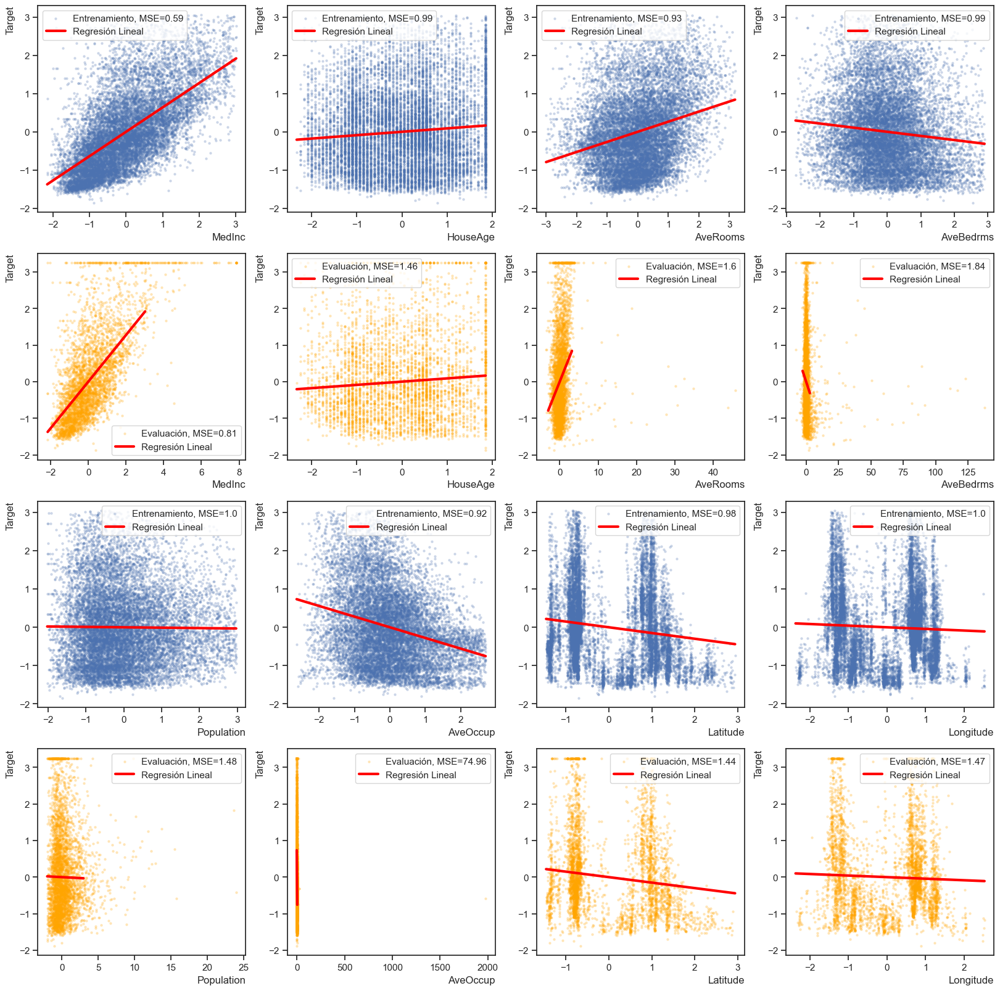

In [17]:
fig, ax = plt.subplots(4,4, figsize=(20,20))

i=0
for feature in ('MedInc', 'HouseAge', 'AveRooms', 'AveBedrms'):

    #Obtener la columna de features
    X_train_f = norm_df[feature].values.reshape(-1, 1)
    y_train_f = norm_df['target'].values.reshape(-1, 1)

    reg = LinearRegression().fit(X_train_f, y_train_f)

    train_pred = reg.predict(X_train_f)
    train_err  = mean_squared_error(y_train_f, train_pred)
    
    x_plot = np.linspace(np.min(X_train_f), np.max(X_train_f), 10000)
    y_plot = reg.predict(x_plot.reshape(-1, 1))

    X_test_f = norm_test_df[feature].values.reshape(-1, 1)
    y_test_f = norm_test_df['target'].values.reshape(-1, 1)
    
    test_pred = reg.predict(X_test_f)
    test_err  = mean_squared_error(y_test_f, test_pred)
    
    ax[0, i].scatter(X_train_f, y_train_f, zorder=2, alpha=0.2, s=5, label=f'Entrenamiento, MSE={np.round(train_err,2)}')
    ax[1, i].scatter(X_test_f, y_test_f, zorder=2, alpha=0.2, s=5, color='orange', label=f'Evaluación, MSE={np.round(test_err,2)}')
    ax[0, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[1, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[0, i].legend()
    ax[1, i].legend()
    ax[0, i].set_xlabel(feature, loc='right')
    ax[0, i].set_ylabel('Target', loc='top')
    ax[1, i].set_xlabel(feature, loc='right')
    ax[1, i].set_ylabel('Target', loc='top')
    #ax[0, i].text(-0.5, 1, f'MSE={np.round(train_err,2)}', fontsize=11, color='black')

    i+=1

i=0
for feature in ('Population', 'AveOccup', 'Latitude', 'Longitude'):

    #Obtener la columna de features
    X_train_f = norm_df[feature].values.reshape(-1, 1)
    y_train_f = norm_df['target'].values.reshape(-1, 1)

    reg = LinearRegression().fit(X_train_f, y_train_f)

    train_pred = reg.predict(X_train_f)
    train_err  = mean_squared_error(y_train_f, train_pred)
    
    x_plot = np.linspace(np.min(X_train_f), np.max(X_train_f), 10000)
    y_plot = reg.predict(x_plot.reshape(-1, 1))

    X_test_f = norm_test_df[feature].values.reshape(-1, 1)
    y_test_f = norm_test_df['target'].values.reshape(-1, 1)
    
    test_pred = reg.predict(X_test_f)
    test_err  = mean_squared_error(y_test_f, test_pred)
    
    ax[2, i].scatter(X_train_f, y_train_f, zorder=2, alpha=0.2, s=5, label=f'Entrenamiento, MSE={np.round(train_err,2)}')
    ax[3, i].scatter(X_test_f, y_test_f, zorder=2, alpha=0.2, s=5, color='orange', label=f'Evaluación, MSE={np.round(test_err,2)}')
    ax[2, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[3, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[2, i].legend()
    ax[3, i].legend()
    ax[2, i].set_xlabel(feature, loc='right')
    ax[2, i].set_ylabel('Target', loc='top')
    ax[3, i].set_xlabel(feature, loc='right')
    ax[3, i].set_ylabel('Target', loc='top')
    #ax[0, i].text(-0.5, 1, f'MSE={np.round(train_err,2)}', fontsize=11, color='black')

    i+=1

Vemos que aquí se vuelven relevantes los outliers en el conjunto de evaluación, haciendo prácticamente imposible observar correlaciones con algunas features y dando errores muy grandes. Si nos focalizamos únicamente en los datos de testeo que entran dentro del rango del conjunto de entrenamiento, podemos realizar las gráficas nuevamente y calcular el MSE:

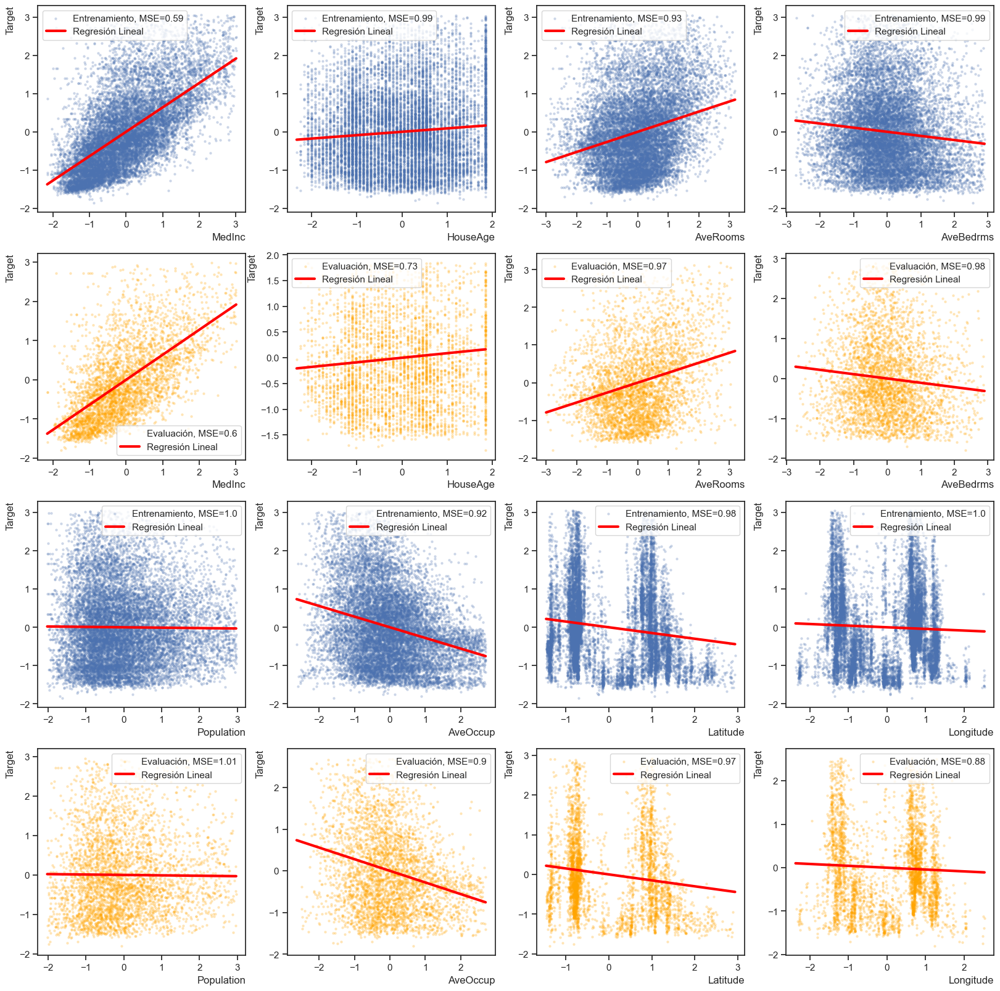

In [18]:
fig, ax = plt.subplots(4,4, figsize=(20,20))

i=0
for feature in ('MedInc', 'HouseAge', 'AveRooms', 'AveBedrms'):

    #Obtener la columna de features
    X_train_f = norm_df[feature].values.reshape(-1, 1)
    y_train_f = norm_df['target'].values.reshape(-1, 1)

    reg = LinearRegression().fit(X_train_f, y_train_f)

    train_pred = reg.predict(X_train_f)
    train_err  = mean_squared_error(y_train_f, train_pred)
    
    x_plot = np.linspace(np.min(X_train_f), np.max(X_train_f), 10000)
    y_plot = reg.predict(x_plot.reshape(-1, 1))

    filter = (norm_test_df[feature]>=np.min(X_train_f))&(norm_test_df[feature]<=np.max(X_train_f))&(norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f))
    X_test_f = norm_test_df[feature][filter].values.reshape(-1, 1)
    y_test_f = norm_test_df['target'][filter].values.reshape(-1, 1)
    
    test_pred = reg.predict(X_test_f)
    test_err  = mean_squared_error(y_test_f, test_pred)
    
    ax[0, i].scatter(X_train_f, y_train_f, zorder=2, alpha=0.2, s=5, label=f'Entrenamiento, MSE={np.round(train_err,2)}')
    ax[1, i].scatter(X_test_f, y_test_f, zorder=2, alpha=0.2, s=5, color='orange', label=f'Evaluación, MSE={np.round(test_err,2)}')
    ax[0, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[1, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[0, i].legend()
    ax[1, i].legend()
    ax[0, i].set_xlabel(feature, loc='right')
    ax[0, i].set_ylabel('Target', loc='top')
    ax[1, i].set_xlabel(feature, loc='right')
    ax[1, i].set_ylabel('Target', loc='top')
    #ax[0, i].text(-0.5, 1, f'MSE={np.round(train_err,2)}', fontsize=11, color='black')

    i+=1

i=0
for feature in ('Population', 'AveOccup', 'Latitude', 'Longitude'):

    #Obtener la columna de features
    X_train_f = norm_df[feature].values.reshape(-1, 1)
    y_train_f = norm_df['target'].values.reshape(-1, 1)

    reg = LinearRegression().fit(X_train_f, y_train_f)

    train_pred = reg.predict(X_train_f)
    train_err  = mean_squared_error(y_train_f, train_pred)
    
    x_plot = np.linspace(np.min(X_train_f), np.max(X_train_f), 10000)
    y_plot = reg.predict(x_plot.reshape(-1, 1))

    filter = (norm_test_df[feature]>=np.min(X_train_f))&(norm_test_df[feature]<=np.max(X_train_f))&(norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f))
    X_test_f = norm_test_df[feature][filter].values.reshape(-1, 1)
    y_test_f = norm_test_df['target'][filter].values.reshape(-1, 1)
    
    test_pred = reg.predict(X_test_f)
    test_err  = mean_squared_error(y_test_f, test_pred)
    
    ax[2, i].scatter(X_train_f, y_train_f, zorder=2, alpha=0.2, s=5, label=f'Entrenamiento, MSE={np.round(train_err,2)}')
    ax[3, i].scatter(X_test_f, y_test_f, zorder=2, alpha=0.2, s=5, color='orange', label=f'Evaluación, MSE={np.round(test_err,2)}')
    ax[2, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[3, i].plot(x_plot, y_plot, color='red', zorder=15, linewidth=3, label='Regresión Lineal')
    ax[2, i].legend()
    ax[3, i].legend()
    ax[2, i].set_xlabel(feature, loc='right')
    ax[2, i].set_ylabel('Target', loc='top')
    ax[3, i].set_xlabel(feature, loc='right')
    ax[3, i].set_ylabel('Target', loc='top')
    #ax[0, i].text(-0.5, 1, f'MSE={np.round(train_err,2)}', fontsize=11, color='black')

    i+=1

Si bien no es del todo correcto realizar la evaluación sobre un conjunto preprocesado (es decir, donde se han eliminado los outliers), utilizar un set mas "sencillo" nos permite comparar mejor los modelos e interpretar el error `MSE`. La solución indicada (en nuestra opinión) sería establecer modelos, tipos de normalización y métricas que sean robustas frente a outliers, para que la presencia de éstos no influya tanto.

A partir de las gráficas y de los errores cuadráticos medios, podemos confirmar que la variable `MedInc` es efectivamente la que mejor permite predecir la variable objetivo a través de un modelo lineal. También vemos que el error en el conjunto de validación/testeo es similar al de entrenamiento, esto no indica que el modelo sigue generalizando correctamente a datos nunca antes vistos, y que quizás haya lugar para establecer un modelo más complejo.

## Ejercicio 4: Regresión Polinomial

En este ejercicio deben entrenar regresiones polinomiales de diferente complejidad, siempre usando **scikit-learn**.

Deben usar **el mismo atributo** seleccionado para el ejercicio anterior.

1. Para varios grados de polinomio, haga lo siguiente:
    1. Instancie y entrene una regresión polinomial.
    2. Prediga y calcule error en entrenamiento y evaluación. Imprima los valores.
    3. Guarde los errores en una lista.
2. Grafique las curvas de error en términos del grado del polinomio.
3. Interprete la curva, identificando el punto en que comienza a haber sobreajuste, si lo hay.
4. Seleccione el modelo que mejor funcione, y grafique el modelo conjuntamente con los puntos.
5. Interprete el resultado, haciendo algún comentario sobre las cualidades del modelo obtenido.

**Observación:** Con algunos atributos se pueden obtener errores en test menores a 40 e incluso a 35.

Vamos a volver a la variable `MedInc` y probar ajustes polinómicos de grado 1 a 15, guardando el error en entrenamiento y en evaluación.

Grado 1
Train error: 0.5944
Test error: 0.60069
Grado 2
Train error: 0.59432
Test error: 0.60033
Grado 3
Train error: 0.5943
Test error: 0.60038
Grado 4
Train error: 0.5935
Test error: 0.59957
Grado 5
Train error: 0.5911
Test error: 0.59874
Grado 6
Train error: 0.59073
Test error: 0.59913
Grado 7
Train error: 0.59057
Test error: 0.59912
Grado 8
Train error: 0.59056
Test error: 0.59915
Grado 9
Train error: 0.59055
Test error: 0.59913
Grado 10
Train error: 0.59055
Test error: 0.59919
Grado 11
Train error: 0.59054
Test error: 0.5992
Grado 12
Train error: 0.59047
Test error: 0.5993
Grado 13
Train error: 0.59047
Test error: 0.59928
Grado 14
Train error: 0.59041
Test error: 0.59966
Grado 15
Train error: 0.5904
Test error: 0.59974


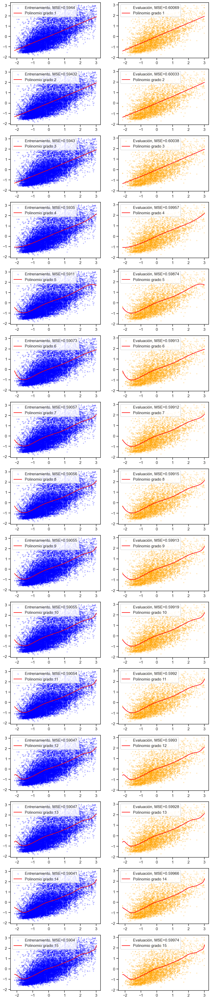

In [19]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

train_error_lin = []
test_error_lin = []

feature = 'MedInc'

X_train_f = norm_df[feature].values.reshape(-1, 1)
y_train_f = norm_df['target'].values.reshape(-1, 1)

#X_test_f = norm_test_df[feature].values.reshape(-1, 1)
#y_test_f = norm_test_df['target'].values.reshape(-1, 1)

filter = (norm_test_df[feature]>=np.min(X_train_f))&(norm_test_df[feature]<=np.max(X_train_f))&(norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f))
X_test_f = norm_test_df[feature][filter].values.reshape(-1, 1)
y_test_f = norm_test_df['target'][filter].values.reshape(-1, 1)

fig, ax = plt.subplots(15, 2, figsize=(10,50))

i=0

for degree in range(1,16):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_lin.append(t_error)
    test_error_lin.append(v_error)
    
    x=np.linspace(np.min(X_train_f),np.max(X_train_f),10000)
    ax[i,0].scatter(X_train_f, y_train_f, color="blue", label=f"Entrenamiento, MSE={np.round(t_error,5)}", alpha=0.2, s=5)
    ax[i,0].plot(x, model.predict(x.reshape(-1, 1)), color="red", label=f"Polinomio grado {degree}")
    ax[i,0].legend()
    ax[i,1].scatter(X_test_f, y_test_f, color="orange" , label=f"Evaluación, MSE={np.round(v_error,5)}", alpha=0.2, s=5)
    ax[i,1].plot(x, model.predict(x.reshape(-1, 1)), color="red", label=f"Polinomio grado {degree}")
    ax[i,1].legend()
    i +=1



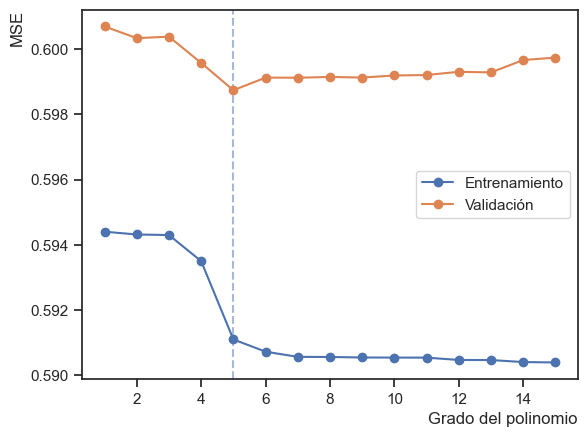

In [20]:
x_err = range(1,16)
plt.plot(x_err, train_error_lin, '-o', label='Entrenamiento', zorder=10)
plt.plot(x_err, test_error_lin, '-o', label='Validación', zorder=10)
plt.xlabel('Grado del polinomio', loc='right')
plt.axvline(5, linestyle='dashed', alpha=0.5, zorder=1)
plt.ylabel('MSE', loc='top')
plt.legend()

El polinomio con $n=5$ presenta una reducción (relativamente) significativa en el MSE, tanto sobre el conjunto de entrenamiento como en el de evaluación. Si bien un polinomio de grado 6 puede mejorar ligeramente la performance en el conjunto de entrenamiento, ésto no se cumple en el conjunto de evaluación, lo cual es propio de un sobreajuste. Como buscamos modelos que generalicen a datos nunca antes vistos, elegimos el polinomio de grado 5.

Grado 5
Train error: 0.5911
Test error: 0.59874


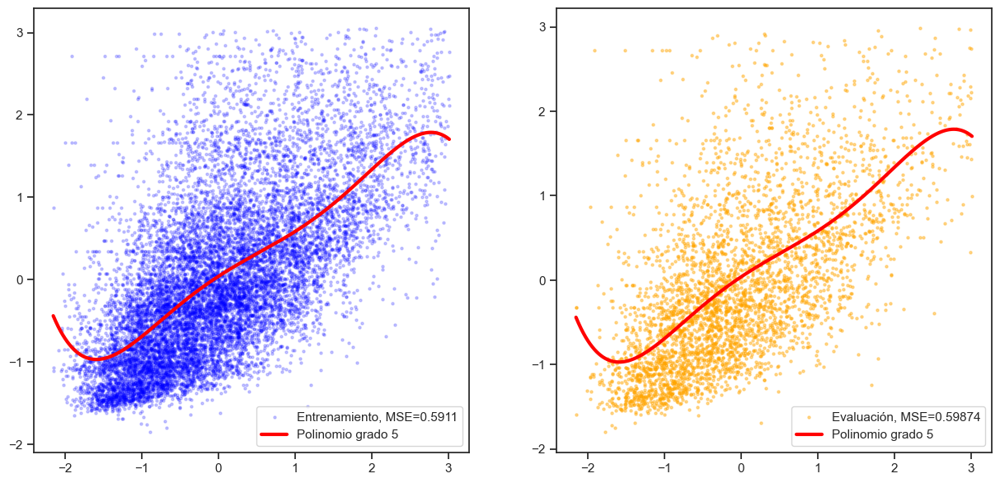

In [21]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

train_error = []
test_error = []

feature = 'MedInc'

X_train_f = norm_df[feature].values.reshape(-1, 1)
y_train_f = norm_df['target'].values.reshape(-1, 1)

filter = (norm_test_df[feature]>=np.min(X_train_f))&(norm_test_df[feature]<=np.max(X_train_f))&(norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f))
X_test_f = norm_test_df[feature][filter].values.reshape(-1, 1)
y_test_f = norm_test_df['target'][filter].values.reshape(-1, 1)

fig, ax = plt.subplots(1, 2, figsize=(15,7))

degree=5

print('Grado', degree)
pf = PolynomialFeatures(degree)
lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
model = make_pipeline(pf, lr)
model.fit(X_train_f, y_train_f)

y_train_pred = model.predict(X_train_f)
y_test_pred = model.predict(X_test_f)

t_error = mean_squared_error(y_train_f, y_train_pred)
v_error = mean_squared_error(y_test_f, y_test_pred)
print(f'Train error: {np.round(t_error,5)}')
print(f'Test error: {np.round(v_error,5)}')

x=np.linspace(np.min(X_train_f),np.max(X_train_f),10000)
ax[0].scatter(X_train_f, y_train_f, color="blue", label=f"Entrenamiento, MSE={np.round(t_error,5)}", alpha=0.2, s=5)
ax[0].plot(x, model.predict(x.reshape(-1, 1)), color="red", label=f"Polinomio grado {degree}", linewidth=3)
ax[0].legend()
ax[1].scatter(X_test_f, y_test_f, color="orange" , label=f"Evaluación, MSE={np.round(v_error,5)}", alpha=0.4, s=5)
ax[1].plot(x, model.predict(x.reshape(-1, 1)), color="red", label=f"Polinomio grado {degree}" , linewidth=3)
ax[1].legend()



El hecho de que el mejor modelo sin sobreajuste sea un polinomio de grado 5 no quiere decir que exista una relación matemática real entre el salario medio de una región y el valor medio de las propiedades allí, sino que esta curva es la que mejor predice los valores del conjunto de datos de acuerdo a la métrica `MSE`, sin sobreajustar al conjunto de validación. No obstante, hay que remarcar que ambos conjuntos fueron extraídos de un mismo dataset, con lo cual no hay cambios relevantes entre un conjunto y otro. Si se presentara un set de datos nuevo, que posiblemente tendría una dispersión distinta, este modelo de grado 5 sería quizás demasiado específico, mientras que el modelo lineal entrenado anteriormente podría capturar una tendencia más general (y sencilla) de los datos y por lo tanto ser más apropiada para datos nuevos. En todo caso, el modelo polinómico no contradice lo visto en el lineal, sino que agrega un poco más de detalle a la relación funcional entre las variables.

## Ejercicio 5: Regresión con más de un Atributo

En este ejercicio deben entrenar regresiones que toman más de un atributo de entrada.

1. Seleccione **dos o tres atributos** entre los más relevantes encontrados en el ejercicio 2.
2. Repita el ejercicio anterior, pero usando los atributos seleccionados. No hace falta graficar el modelo final.
3. Interprete el resultado y compare con los ejercicios anteriores. ¿Se obtuvieron mejores modelos? ¿Porqué?

En base a lo que vimos en los ejercicios anteriores, tiene sentido buscar la/s siguiente/s variable/s con mejor MSE, tanto en entrenamiento como en validación. Podemos utilizar entonces `AveOccup` y `HouseAge`. Podemos estudiar los siguientes modelos:
- `MedianInc` y `AveOccup`
- `MedianInc` y `HouseAge`
- `MedianInc`, `AveOccup` y `HouseAge`

Además, podríamos proponer ajustes polinómicos de diversos grados, y ver cuál es el óptimo, siguiendo la idea del ej.4

(13077, 2) (3717, 2)
Grado 1
Train error: 0.53047
Test error: 0.54565
Grado 2
Train error: 0.49956
Test error: 0.51163
Grado 3
Train error: 0.4981
Test error: 0.50891
Grado 4
Train error: 0.48774
Test error: 0.50165
Grado 5
Train error: 0.48364
Test error: 0.49918
Grado 6
Train error: 0.4822
Test error: 0.49689
Grado 7
Train error: 0.48087
Test error: 0.49782
Grado 8
Train error: 0.4798
Test error: 0.49809
Grado 9
Train error: 0.47938
Test error: 0.49804
Grado 10
Train error: 0.47868
Test error: 0.4982
Grado 11
Train error: 0.4785
Test error: 0.49888
Grado 12
Train error: 0.47811
Test error: 0.50305
Grado 13
Train error: 0.47759
Test error: 0.50306
Grado 14
Train error: 0.4769
Test error: 0.50934
Grado 15
Train error: 0.47643
Test error: 0.51048


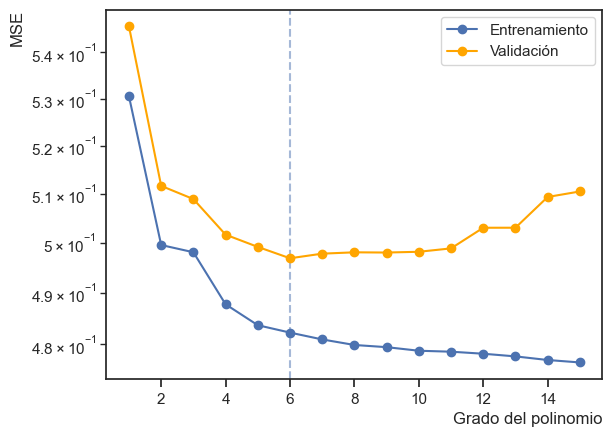

In [22]:
# 1. Resolver acá. Ayuda (con dos atributos):
var1 = 'MedInc'
var2 = 'AveOccup'
%matplotlib inline
X_train_f = norm_df[[var1, var2]].values
y_train_f = norm_df['target'].values.reshape(-1, 1)

filter1 = ((norm_test_df[var1]>=np.min(X_train_f[:,0]))&(norm_test_df[var1]<=np.max(X_train_f[:,0])))
filter2 = ((norm_test_df[var2]>=np.min(X_train_f[:,1]))&(norm_test_df[var2]<=np.max(X_train_f[:,1])))
filter3 = ((norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f)))

X_test_f = norm_test_df[filter1&filter2&filter3][[var1, var2]].values
y_test_f = norm_test_df[filter1&filter2&filter3]['target'].values.reshape(-1, 1)


print(X_train_f.shape, X_test_f.shape)

train_error_2d_ave = []
test_error_2d_ave = []

for degree in range(1,16):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_2d_ave.append(t_error)
    test_error_2d_ave.append(v_error)

x_err = range(1,16)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_2d_ave, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_2d_ave, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.set_yscale('log')
ax.axvline(6, linestyle='dashed', alpha=0.5)
ax.legend()


Vemos que la incorporación de una segunda variable nos permite "seguir entrenando" con un polinomio de grado 6 antes de que la MSE de validación vuelva a subir. Si bien no es necesario, podemos graficar para interpretar este resultado (de hecho en el proceso de graficar encontramos algunos errores en el ajuste 2D).

In [23]:
import plotly.graph_objects as go
degree=6
print('Grado', degree)
pf = PolynomialFeatures(degree)
lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
model = make_pipeline(pf, lr)
model.fit(X_train_f, y_train_f)

x1_range = np.linspace(X_train_f[:,0].min(), X_train_f[:,0].max(), 100)
x2_range = np.linspace(X_train_f[:,1].min(), X_train_f[:,1].max(), 100)
x1_grid, x2_grid = np.meshgrid(x1_range, x2_range)
X_grid = np.c_[x1_grid.ravel(), x2_grid.ravel()]

y_grid = model.predict(X_grid).reshape(x1_grid.shape)

# Create the 3D scatter plot of the original data points
scatter1 = go.Scatter3d(
    x=X_train_f[:,0], 
    y=X_train_f[:,1], 
    z=y_train_f.reshape(-1), 
    mode='markers', 
    marker=dict(size=2, color='blue', opacity=0.2),
    name='Entrenamiento',
    showlegend=True
)

scatter2 = go.Scatter3d(
    x=X_test_f[:,0], 
    y=X_test_f[:,1], 
    z=y_test_f.reshape(-1), 
    mode='markers', 
    marker=dict(size=2, color='orange', opacity=0.3),
    name='Evaluación',
    showlegend=True
)

# Create the 3D surface plot of the fitted plane
surface = go.Surface(
    x=x1_grid, 
    y=x2_grid, 
    z=y_grid, 
    opacity=0.4,
    colorscale='Reds',
    name='Ajuste Polinómico',
    showscale=False,  # Do not show color scale bar
    
)

# Create the figure and add the scatter and surface plots
fig = go.Figure(data=[scatter1, scatter2, surface])


# Set the layout for the plot
fig.update_layout(
    scene=dict(
        xaxis_title='MedInc',
        yaxis_title='AveOccup',
        zaxis_title='target'
    ),
    title='Gráfica 3D de los datos y del modelo polinómico ajustado'
)

fig.update_layout(
    width=800,  # Set the width of the plot
    height=600  # Set the height of the plot
)
# Show the plot
fig.show()


Grado 6


Vamos a hacer lo mismo, pero ahora usando la variable `HouseAge`.

(13077, 2) (3870, 2)
Grado 1
Train error: 0.55312
Test error: 0.56051
Grado 2
Train error: 0.54199
Test error: 0.55095
Grado 3
Train error: 0.53753
Test error: 0.54763
Grado 4
Train error: 0.53527
Test error: 0.54538
Grado 5
Train error: 0.5307
Test error: 0.54252
Grado 6
Train error: 0.53001
Test error: 0.54376
Grado 7
Train error: 0.5279
Test error: 0.54026
Grado 8
Train error: 0.52731
Test error: 0.54096
Grado 9
Train error: 0.52647
Test error: 0.5483


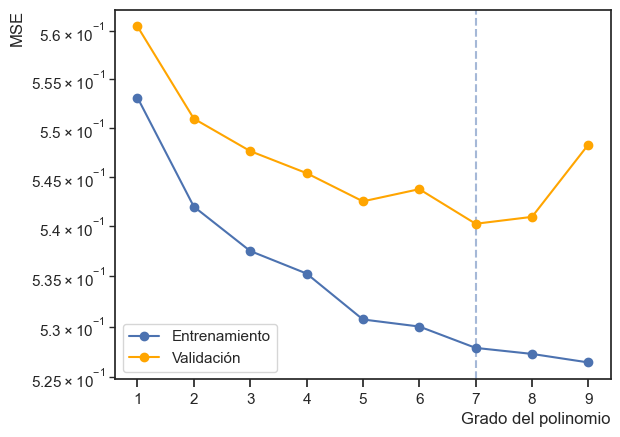

In [24]:
# 1. Resolver acá. Ayuda (con dos atributos):
var1 = 'MedInc'
var2 = 'HouseAge'
X_train_f = norm_df[[var1, var2]].values
y_train_f = norm_df['target'].values.reshape(-1, 1)

filter1 = ((norm_test_df[var1]>=np.min(X_train_f[:,0]))&(norm_test_df[var1]<=np.max(X_train_f[:,0])))
filter2 = ((norm_test_df[var2]>=np.min(X_train_f[:,1]))&(norm_test_df[var2]<=np.max(X_train_f[:,1])))
filter3 = ((norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f)))

X_test_f = norm_test_df[filter1&filter2&filter3][[var1, var2]].values
y_test_f = norm_test_df[filter1&filter2&filter3]['target'].values.reshape(-1, 1)


print(X_train_f.shape, X_test_f.shape)

train_error_2d_age = []
test_error_2d_age = []

for degree in range(1,10):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_2d_age.append(t_error)
    test_error_2d_age.append(v_error)

x_err = range(1,10)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_2d_age, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_2d_age, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.set_yscale('log')
ax.axvline(7, linestyle='dashed', alpha=0.5)
ax.legend()


Vemos que el mejor caso se obtiene con un polinomio de grado 7. También podemos comparar este modelo con el anterior:

Text(0.5, 1.0, 'MSE en Evaluación')

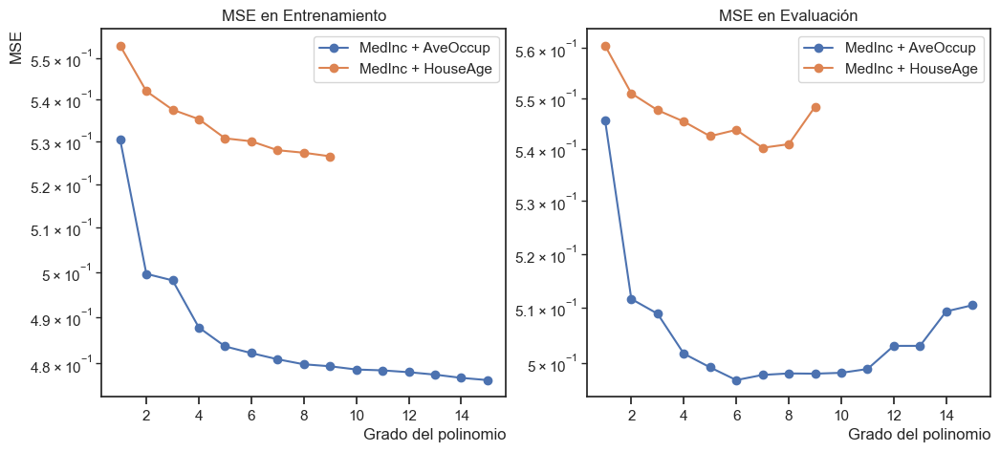

In [25]:
fig, ax = plt.subplots(1,2, figsize=(12,5))

x_err_ave = range(1,16)
x_err_age = range(1,10)

ax[0].plot(x_err_ave, train_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[0].plot(x_err_age, train_error_2d_age, '-o', label='MedInc + HouseAge', zorder=10)
ax[0].set_xlabel('Grado del polinomio', loc='right')
ax[0].set_ylabel('MSE', loc='top')
ax[0].set_yscale('log')
ax[0].legend()
ax[0].set_title('MSE en Entrenamiento')

ax[1].plot(x_err_ave, test_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[1].plot(x_err_age, test_error_2d_age, '-o', label='MedInc + HouseAge', zorder=10)
ax[1].set_xlabel('Grado del polinomio', loc='right')
ax[1].set_yscale('log')
ax[1].legend()
ax[1].set_title('MSE en Evaluación')

Claramente el modelo con `AveOccup` es mejor que el que entrenamos recién. Lo único que nos falta es hacer uno con las 3 variables, y compararlo también.

(13077, 3) (3717, 3)
Grado 1
Train error: 0.48973
Test error: 0.50362
Grado 2
Train error: 0.45941
Test error: 0.47245
Grado 3
Train error: 0.44871
Test error: 0.4655
Grado 4
Train error: 0.43643
Test error: 0.45932
Grado 5
Train error: 0.42874
Test error: 0.45563
Grado 6
Train error: 0.42477
Test error: 0.44999
Grado 7
Train error: 0.42067
Test error: 0.45403
Grado 8
Train error: 0.41848
Test error: 0.45994
Grado 9
Train error: 0.41567
Test error: 0.464


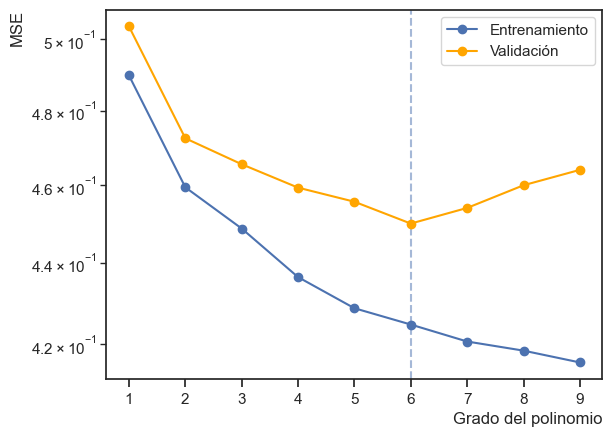

In [26]:
# 1. Resolver acá. Ayuda (con dos atributos):
var1 = 'MedInc'
var2 = 'AveOccup'
var3 = 'HouseAge'

X_train_f = norm_df[[var1, var2, var3]].values
y_train_f = norm_df['target'].values.reshape(-1, 1)

filter1 = ((norm_test_df[var1]>=np.min(X_train_f[:,0]))&(norm_test_df[var1]<=np.max(X_train_f[:,0])))
filter2 = ((norm_test_df[var2]>=np.min(X_train_f[:,1]))&(norm_test_df[var2]<=np.max(X_train_f[:,1])))
filter3 = ((norm_test_df[var3]>=np.min(X_train_f[:,2]))&(norm_test_df[var3]<=np.max(X_train_f[:,2])))
filter4 = ((norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f)))

X_test_f = norm_test_df[filter1&filter2&filter3&filter4][[var1, var2, var3]].values
y_test_f = norm_test_df[filter1&filter2&filter3&filter4]['target'].values.reshape(-1, 1)


print(X_train_f.shape, X_test_f.shape)

train_error_3d = []
test_error_3d = []

for degree in range(1,10):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_3d.append(t_error)
    test_error_3d.append(v_error)

x_err = range(1,10)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_3d, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_3d, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.set_yscale('log')
ax.axvline(6, linestyle='dashed', alpha=0.5)
ax.legend()


(0.43, 0.65)

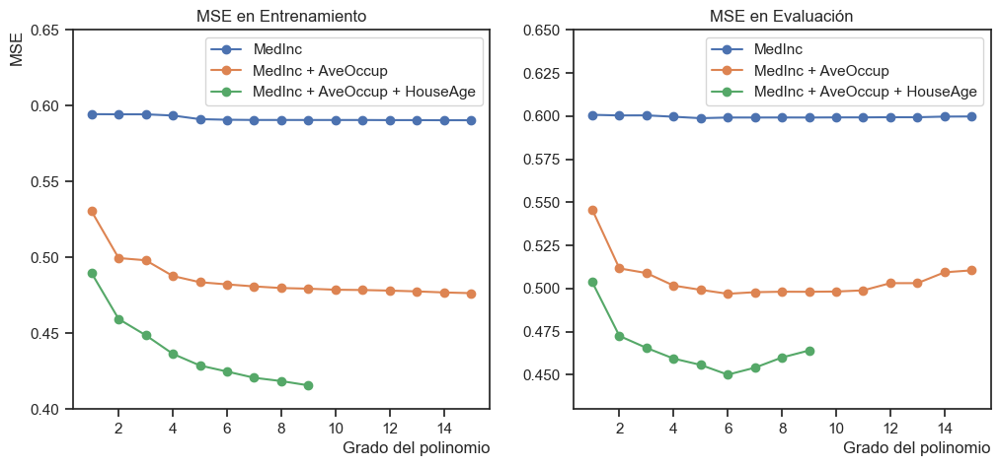

In [27]:
fig, ax = plt.subplots(1,2, figsize=(12,5))

x_err_lin = range(1,16)
x_err_ave = range(1,16)
x_err_age = range(1,10)

ax[0].plot(x_err_lin, train_error_lin, '-o', label='MedInc', zorder=10)
ax[0].plot(x_err_ave, train_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[0].plot(x_err_age, train_error_3d, '-o', label='MedInc + AveOccup + HouseAge', zorder=10)
ax[0].set_xlabel('Grado del polinomio', loc='right')
ax[0].set_ylabel('MSE', loc='top')
ax[0].legend()
ax[0].set_title('MSE en Entrenamiento')
ax[0].set_ylim(0.4, 0.65)

ax[1].plot(x_err_lin, test_error_lin, '-o', label='MedInc', zorder=10)
ax[1].plot(x_err_ave, test_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[1].plot(x_err_age, test_error_3d, '-o', label='MedInc + AveOccup + HouseAge', zorder=10)
ax[1].set_xlabel('Grado del polinomio', loc='right')
ax[1].legend()
ax[1].set_title('MSE en Evaluación')
ax[1].set_ylim(0.43, 0.65)

Concluimos que el mejor modelo es el que usa las 3 variables. También es interesante ver que el modelo de una variable, entrenado en el ejercicio anterior, se ve casi constante frente a las mejoras que traen los modelos de dos o tres variables. Este resultado es llamativo.

#### Adicional: ajuste polinómico sobre el mapa

Ya que estuvimos analizando las variables `Latitute` y `Longitude`y vimos que existen zonas más caras y zonas más baratas, podemos hacer un ajuste polinómico 2D sobre ellas.

(13077, 2) (3916, 2)
Grado 1
Train error: 0.71728
Test error: 0.73859
Grado 2
Train error: 0.7071
Test error: 0.72204
Grado 3
Train error: 0.68863
Test error: 0.71074
Grado 4
Train error: 0.63065
Test error: 0.67
Grado 5
Train error: 0.59785
Test error: 0.62132
Grado 6
Train error: 0.58975
Test error: 0.61443
Grado 7
Train error: 0.58454
Test error: 0.61158
Grado 8
Train error: 0.5812
Test error: 0.61779
Grado 9
Train error: 0.57286
Test error: 0.74246


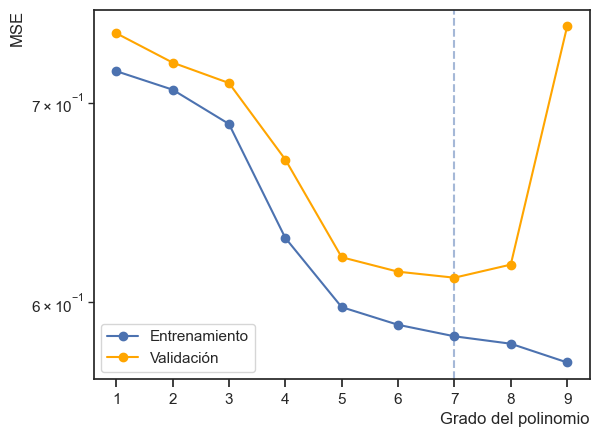

In [28]:
# 1. Resolver acá. Ayuda (con dos atributos):
var1 = 'Latitude'
var2 = 'Longitude'
X_train_f = norm_df[[var1, var2]].values
y_train_f = norm_df['target'].values.reshape(-1, 1)

filter1 = ((norm_test_df[var1]>=np.min(X_train_f[:,0]))&(norm_test_df[var1]<=np.max(X_train_f[:,0])))
filter2 = ((norm_test_df[var2]>=np.min(X_train_f[:,1]))&(norm_test_df[var2]<=np.max(X_train_f[:,1])))
filter3 = ((norm_test_df['target']>=np.min(y_train_f))&(norm_test_df['target']<=np.max(X_train_f)))

X_test_f = norm_test_df[filter1&filter2&filter3][[var1, var2]].values
y_test_f = norm_test_df[filter1&filter2&filter3]['target'].values.reshape(-1, 1)


print(X_train_f.shape, X_test_f.shape)

train_error_2d_map = []
test_error_2d_map = []

for degree in range(1,10):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_2d_map.append(t_error)
    test_error_2d_map.append(v_error)

x_err = range(1,10)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_2d_map, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_2d_map, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.set_yscale('log')
ax.axvline(7, linestyle='dashed', alpha=0.5)
ax.legend()


In [29]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, mapping

# El siguiente código permite obtener las coordenadas de la frontera de California para poder graficarla
url = 'https://raw.githubusercontent.com/johan/world.geo.json/master/countries/USA/CA.geo.json'
california = gpd.read_file(url)
california = california.to_crs(epsg=4326)
boundary = california.geometry.iloc[0]
poly_mapped = mapping(boundary)
poly_coordinates = np.array(poly_mapped['coordinates'][0])

In [37]:
import plotly as py
from shapely.geometry import Polygon, Point
import random

var1 = 'Latitude'
var2 = 'Longitude'
X_train_f = norm_df[[var1, var2]].values
y_train_f = norm_df['target'].values.reshape(-1, 1)

degree=7
print('Grado', degree)
pf = PolynomialFeatures(degree)
lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
model = make_pipeline(pf, lr)
model.fit(X_train_f, y_train_f)




# Define the polygon using a list of (x, y) points

# Define the number of points to generate
num_points = 100

# Generate a grid of points that covers the bounding box of the polygon
min_x, min_y, max_x, max_y = boundary.bounds
x_grid = np.linspace(min_x, max_x, num_points)
y_grid = np.linspace(min_y, max_y, num_points)
xx, yy = np.meshgrid(x_grid, y_grid)
grid_points = np.vstack([xx.ravel(), yy.ravel()]).T

# Filter points that are inside the polygon
inside_points = [Point(p).coords[0] for p in grid_points if boundary.contains(Point(p))]
#print(inside_points)
surface = np.array(inside_points)
surface_grid = surface[:, [1, 0]]
surface_scaled = surface_grid

surface_scaled[:,0]=(surface_scaled[:,0]-filtered_df[var1].mean())/filtered_df[var1].std()

surface_scaled[:,1]=(surface_scaled[:,1]-filtered_df[var2].mean())/filtered_df[var2].std()
print(surface_scaled.shape)

z_grid = model.predict(surface_scaled).reshape(surface_grid[:,0].shape)
z_grid = z_grid*filtered_df['target'].std()+filtered_df['target'].mean()
print(z_grid.shape)
z_grid[z_grid>10]=0
#y_grid[y_grid<-0.1]=0
#print(y_grid)

x1_range = x1_range*filtered_df[var1].std()+filtered_df[var1].mean()
x2_range = x2_range*filtered_df[var2].std()+filtered_df[var2].mean()
x1_grid, x2_grid = np.meshgrid(x1_range, x2_range)


data3d=[dict(type='scatter3d',#the points on the boundaries of France regions
             x=poly_coordinates[:,1],
             y=poly_coordinates[:,0],
             z=np.zeros(len(x)),
             mode='lines',
             line=dict(width=1.5, color='blue')
            ),
    dict(type= 'scatter3d',
        x=surface[:,1], 
        y=surface[:,0], 
        z=z_grid, 
        opacity=0.7,
        mode = 'lines',
        marker=dict(size=2, color='grey',  opacity=0.3),
        name='Ajuste Polinómico'),
    dict(type='scatter3d',
        x=filtered_df['Latitude'],
        y=filtered_df['Longitude'],
        z=filtered_df['target'],
        mode='markers',
        marker=dict(size=2, color='red',  opacity=0.3))
       ]

axis3d = dict(
showbackground=True, 
backgroundcolor="rgb(230, 230,230)",
gridcolor="rgb(255, 255, 255)",      
zerolinecolor="rgb(255, 255, 255)", 
ticklen=4,
showticklabels=True    
    )

title="Mapa de California"

layout3d=dict(title=title,
              font=dict(family='Balto'),
              showlegend=False, 
              autosize=False,
              width=800, height=800,
              margin=dict(t=120),
              scene=dict(camera=dict(eye=dict(x=1.15, y=-1.15, z=0.5)),
                         xaxis=dict(axis3d, **{'title': 'Latitud'}),
                         yaxis=dict(axis3d, **{'title': 'Longitud'}),
                         zaxis=dict(axis3d, **{'range':[-0.01, 10]}),
               aspectratio=dict(x=1, y=1, z=0.5)
             ))

fig = go.Figure(data3d)
fig.update_layout(layout3d)
fig.show()
print(z_grid)

Grado 7
(4175, 2)
(4175,)


[1.71448697 1.59604316 1.51563927 ... 0.         0.         0.        ]


En la gráfica de arriba, los puntos rojos representan el conjunto de entrenamiento (la altura es el valor de la variable objetivo), mientras que las lineas grises representan al modelo entrenado (evaluado sobre una grilla uniforme de puntos contenidos en la región de California).
Si bien fue posible establecer un 'mapa de relieve' que busca describir el precio de las propiedades, sería necesario perfeccionar la implementación (en particular la definición de los puntos de la grilla, su estandarización, etc.) para poder interpretar correctamente los resultados. Además, el hecho de que los puntos deban estar confinados por una curva irregular dificulta graficar cómodamente utilizando las herramientas habituales de gráficos en 3D.

Discutiendo con el grupo, concluimos que quizás tendría más sentido tomar la información geográfica para realizar clústers y definir zonas diferenciadas, que luego puedan ser tomadas como variables categóricas para incorporar en la predicción de la variable objetivo.

### Conclusiones generales:
- Se pudieron establecer una variedad de modelos para ajustar los datos, observando que el mejor de todos fue el que incorpora más variables, es decir el más complejo.
- Se consiguió optimizar el grado del polinomio para cada modelo y variable elegidas, evitando el sobreajuste. A su vez, se encontró que el sobreajuste conduce a errores mucho mayores en los modelos de más de una variable.
- La presencia de outliers en el conjunto de datos influye notoriamente sobre el modelo, dificultando la optimización de la métrica `MSE`.
- Existen variables que aportan a las predicciones, variables que no lo hacen (al menos en modelos lineales de una variable) y variables que sólo pueden interpretarse en conjunto con otra variable, como los es el caso de la latitud y la longitud. Las posibilidades de trabajo con las variables geográficas son varias y la implementación de esta información junto a las demás variables vistas aún debe ser estudiada. 

## Más ejercicios (opcionales)

### Ejercicio 6: A Todo Feature

Entrene y evalúe regresiones pero utilizando todos los atributos de entrada (va a andar mucho más lento). Estudie los resultados.

### Ejercicio 7: Regularización

Entrene y evalúe regresiones con regularización "ridge". Deberá probar distintos valores de "alpha" (fuerza de la regularización). ¿Mejoran los resultados?


(13077, 8) (3243, 8)
Grado 1
Train error: 0.36235
Test error: 0.3467
Grado 2
Train error: 0.30551
Test error: 0.29101
Grado 3
Train error: 0.27759
Test error: 0.27279
Grado 4
Train error: 0.23574
Test error: 0.26422
Grado 5
Train error: 0.19538
Test error: 0.34884
Grado 6
Train error: 0.15191
Test error: 2.39458
Grado 7
Train error: 0.08948
Test error: 215.31335


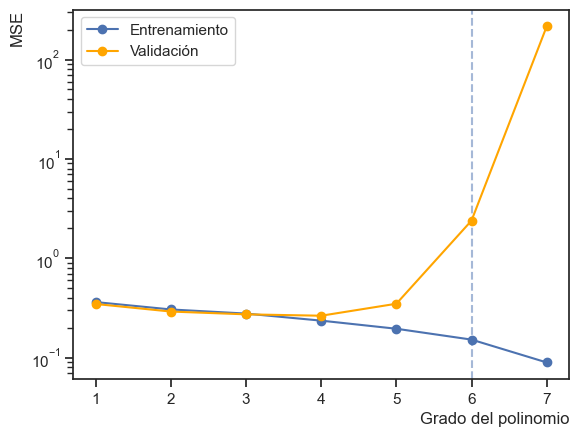

In [31]:
# 1. Resolver acá. Ayuda (con dos atributos):
var1 = 'MedInc'
var2 = 'AveOccup'
var3 = 'HouseAge'

X_train_f = norm_df.drop(columns=['target']).values
y_train_f = norm_df['target'].values.reshape(-1, 1)

ranges = {col: (norm_df[col].min(), norm_df[col].max()) for col in norm_df.columns}

for col, (min_val, max_val) in ranges.items():
    norm_test_df = norm_test_df[(norm_test_df[col] >= min_val) & (norm_test_df[col] <= max_val)]

X_test_f = norm_test_df.drop(columns=['target']).values
y_test_f = norm_test_df['target'].values.reshape(-1, 1)


print(X_train_f.shape, X_test_f.shape)

train_error_all = []
test_error_all = []

for degree in range(1,8):
    print('Grado', degree)
    pf = PolynomialFeatures(degree)
    lr = LinearRegression(fit_intercept=False)  # el bias ya esta como feature
    model = make_pipeline(pf, lr)
    model.fit(X_train_f, y_train_f)
    
    y_train_pred = model.predict(X_train_f)
    y_test_pred = model.predict(X_test_f)
    
    t_error = mean_squared_error(y_train_f, y_train_pred)
    v_error = mean_squared_error(y_test_f, y_test_pred)
    print(f'Train error: {np.round(t_error,5)}')
    print(f'Test error: {np.round(v_error,5)}')
    train_error_all.append(t_error)
    test_error_all.append(v_error)

x_err = range(1,8)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_all, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_all, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.set_yscale('log')
ax.axvline(6, linestyle='dashed', alpha=0.5)
ax.legend()

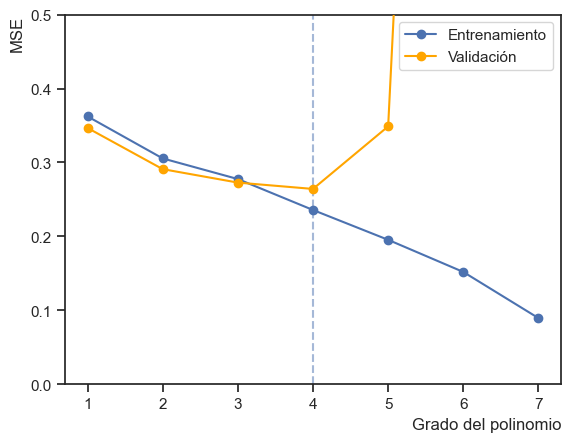

In [34]:
x_err = range(1,8)

fig, ax = plt.subplots()
ax.plot(x_err, train_error_all, '-o', label='Entrenamiento', zorder=10)
ax.plot(x_err, test_error_all, '-o', label='Validación', zorder=10, color='orange')
ax.set_xlabel('Grado del polinomio', loc='right')
ax.set_ylabel('MSE', loc='top')
ax.axvline(4, linestyle='dashed', alpha=0.5)
ax.set_ylim(0,0.5)
ax.legend()

Vemos que el modelo alcanza un overfitting mucho más rápido, y podríamos quedarnos con un polinomio de grado 3 o de grado 4 como mejor modelo. Si lo comparamos con los ya entrenados:

(0.05, 0.65)

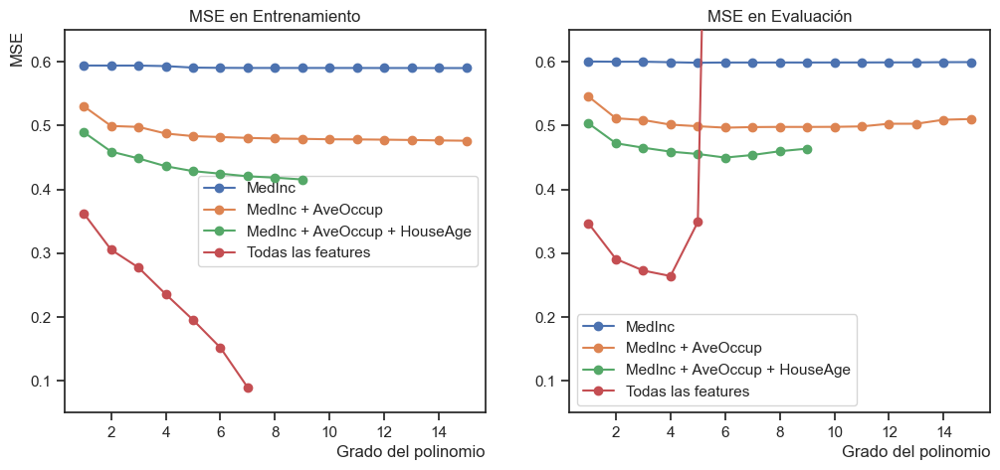

In [36]:
fig, ax = plt.subplots(1,2, figsize=(12,5))

x_err_lin = range(1,16)
x_err_ave = range(1,16)
x_err_age = range(1,10)
x_err_all = range(1,8)

ax[0].plot(x_err_lin, train_error_lin, '-o', label='MedInc', zorder=10)
ax[0].plot(x_err_ave, train_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[0].plot(x_err_age, train_error_3d, '-o', label='MedInc + AveOccup + HouseAge', zorder=10)
ax[0].plot(x_err_all, train_error_all, '-o', label='Todas las features', zorder=10)
ax[0].set_xlabel('Grado del polinomio', loc='right')
ax[0].set_ylabel('MSE', loc='top')
ax[0].legend(loc='center right')
ax[0].set_title('MSE en Entrenamiento')
ax[0].set_ylim(0.05, 0.65)

ax[1].plot(x_err_lin, test_error_lin, '-o', label='MedInc', zorder=10)
ax[1].plot(x_err_ave, test_error_2d_ave, '-o', label='MedInc + AveOccup', zorder=10)
ax[1].plot(x_err_age, test_error_3d, '-o', label='MedInc + AveOccup + HouseAge', zorder=10)
ax[1].plot(x_err_all, test_error_all, '-o', label='Todas las features', zorder=10)
ax[1].set_xlabel('Grado del polinomio', loc='right')
ax[1].legend()
ax[1].set_title('MSE en Evaluación')
ax[1].set_ylim(0.05, 0.65)